# Image Recognition

In [1]:
from torchvision import models

In [2]:
dir(models)

['AlexNet',
 'DenseNet',
 'Inception3',
 'ResNet',
 'SqueezeNet',
 'VGG',
 '__builtins__',
 '__cached__',
 '__doc__',
 '__file__',
 '__loader__',
 '__name__',
 '__package__',
 '__path__',
 '__spec__',
 'alexnet',
 'densenet',
 'densenet121',
 'densenet161',
 'densenet169',
 'densenet201',
 'inception',
 'inception_v3',
 'resnet',
 'resnet101',
 'resnet152',
 'resnet18',
 'resnet34',
 'resnet50',
 'squeezenet',
 'squeezenet1_0',
 'squeezenet1_1',
 'vgg',
 'vgg11',
 'vgg11_bn',
 'vgg13',
 'vgg13_bn',
 'vgg16',
 'vgg16_bn',
 'vgg19',
 'vgg19_bn']

In [3]:
alexnet = models.AlexNet()

In [4]:
resnet = models.resnet101(pretrained=True)

In [5]:
resnet

ResNet(
  (conv1): Conv2d(3, 64, kernel_size=(7, 7), stride=(2, 2), padding=(3, 3), bias=False)
  (bn1): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
  (relu): ReLU(inplace)
  (maxpool): MaxPool2d(kernel_size=3, stride=2, padding=1, dilation=1, ceil_mode=False)
  (layer1): Sequential(
    (0): Bottleneck(
      (conv1): Conv2d(64, 64, kernel_size=(1, 1), stride=(1, 1), bias=False)
      (bn1): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      (conv2): Conv2d(64, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), bias=False)
      (bn2): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      (conv3): Conv2d(64, 256, kernel_size=(1, 1), stride=(1, 1), bias=False)
      (bn3): BatchNorm2d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      (relu): ReLU(inplace)
      (downsample): Sequential(
        (0): Conv2d(64, 256, kernel_size=(1, 1), stride=(1, 1), bias=F

In [6]:
from torchvision import transforms
precrop = transforms.Compose([
    transforms.Resize(256),
    transforms.CenterCrop(224)
    ])
preprocess = transforms.Compose([
    transforms.Resize(256),
    transforms.CenterCrop(224),
    transforms.ToTensor(),
    transforms.Normalize(
        mean=[0.485, 0.456, 0.406],
        std=[0.229, 0.224, 0.225]
    )])

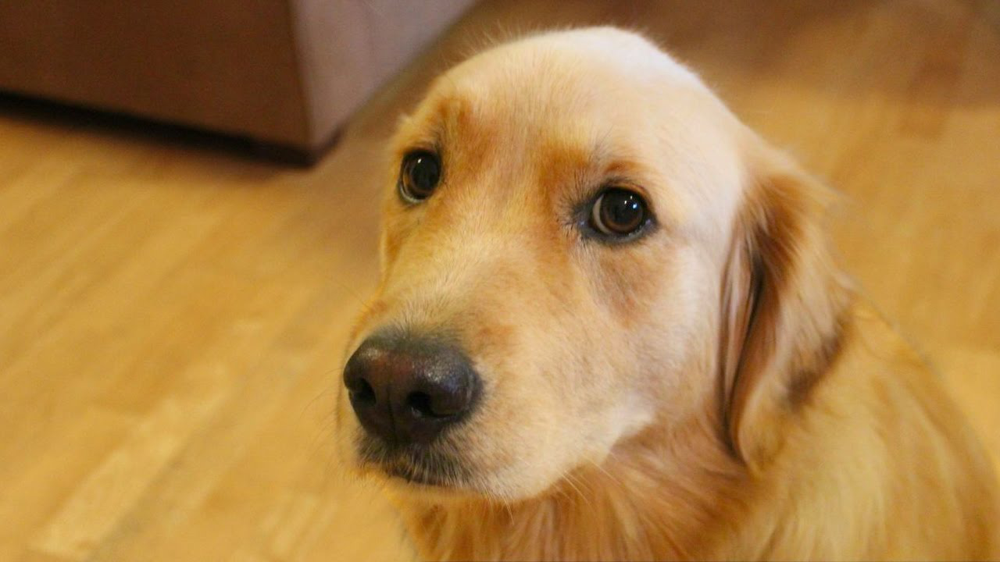

In [7]:
from PIL import Image
img = Image.open("data/dogs/bobby.jpg")
img

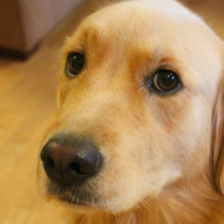

In [8]:
precrop(img)

In [9]:
img_t = preprocess(img)

In [10]:
import torch
from torch.autograd import Variable
img_var = Variable(torch.unsqueeze(img_t, 0))

In [11]:
resnet.eval()

ResNet(
  (conv1): Conv2d(3, 64, kernel_size=(7, 7), stride=(2, 2), padding=(3, 3), bias=False)
  (bn1): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
  (relu): ReLU(inplace)
  (maxpool): MaxPool2d(kernel_size=3, stride=2, padding=1, dilation=1, ceil_mode=False)
  (layer1): Sequential(
    (0): Bottleneck(
      (conv1): Conv2d(64, 64, kernel_size=(1, 1), stride=(1, 1), bias=False)
      (bn1): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      (conv2): Conv2d(64, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), bias=False)
      (bn2): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      (conv3): Conv2d(64, 256, kernel_size=(1, 1), stride=(1, 1), bias=False)
      (bn3): BatchNorm2d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      (relu): ReLU(inplace)
      (downsample): Sequential(
        (0): Conv2d(64, 256, kernel_size=(1, 1), stride=(1, 1), bias=F

In [12]:
out = resnet(img_var)

In [13]:
out.size()

torch.Size([1, 1000])

In [14]:
with open('data/imagenet_classes.txt') as f:
    labels = f.readlines()

In [15]:
_, index = torch.max(out, 1)

In [16]:
labels[index.data[0]]

'golden retriever\n'

In [17]:
_, indices = torch.sort(out, descending=True)
[labels[idx] for idx in indices.data[0]][0:5]

['golden retriever\n',
 'Labrador retriever\n',
 'cocker spaniel, English cocker spaniel, cocker\n',
 'redbone\n',
 'tennis ball\n']

In [18]:
from pathlib import Path

from PIL import Image
import torch
from torch.autograd import Variable
from torchvision import transforms


class ImageRecognizer:
    resnet = models.resnet101(pretrained=True)
    resnet.eval()
    
    with open('data/imagenet_classes.txt') as f:
        labels = f.readlines()
    
    precrop = transforms.Compose([
        transforms.Resize(256),
        transforms.CenterCrop(224)
        ])
    preprocess = transforms.Compose([
        transforms.Resize(256),
        transforms.CenterCrop(224),
        transforms.ToTensor(),
        transforms.Normalize(
            mean=[0.485, 0.456, 0.406],
            std=[0.229, 0.224, 0.225]
        )])
        
    def __init__(self, fp: Path):
        self.img = Image.open(str(fp))
        
    def show(self) -> None:
        display(self.img)
        display(ImageRecognizer.precrop(self.img))
        
    def classify(self) -> str:
        img_t = ImageRecognizer.preprocess(self.img)
        img_var = Variable(torch.unsqueeze(img_t, 0))
        out = resnet(img_var)
        _, index = torch.max(out, 1)
        return labels[index.data[0]]

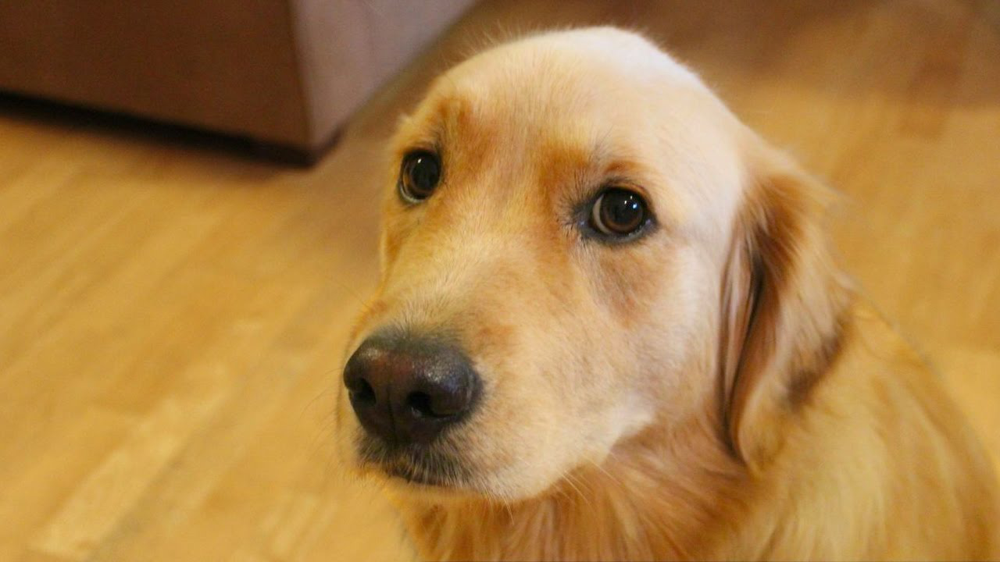

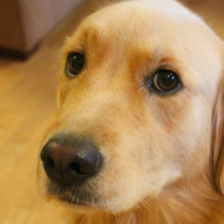

'golden retriever\n'

In [19]:
ir = ImageRecognizer("data/dogs/bobby.jpg")
ir.show()
ir.classify()

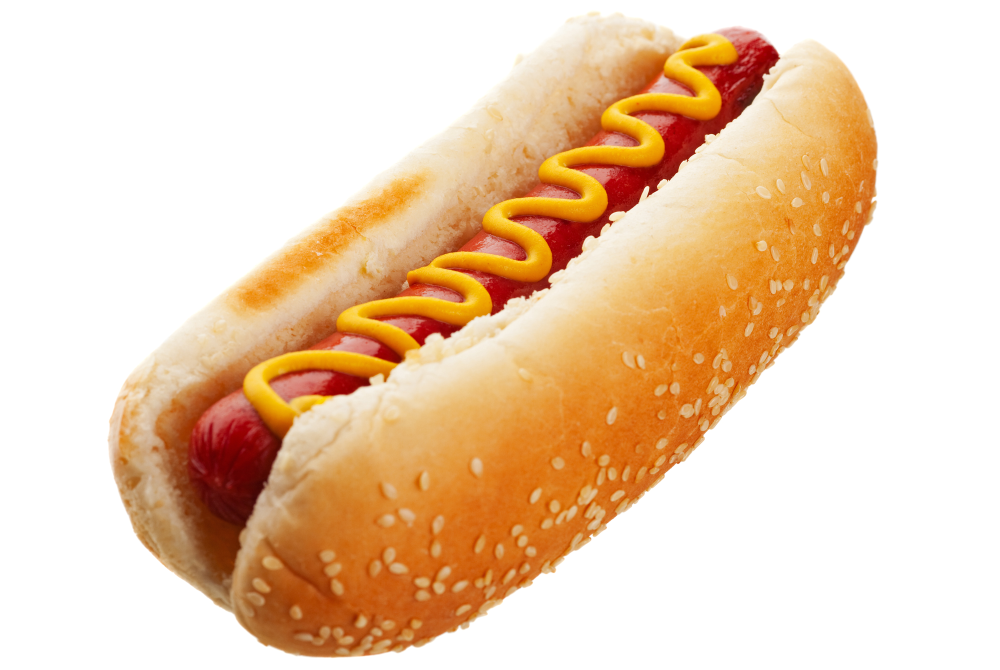

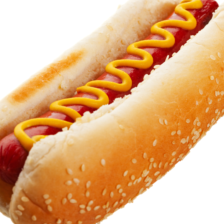

hotdog, hot dog, red hot



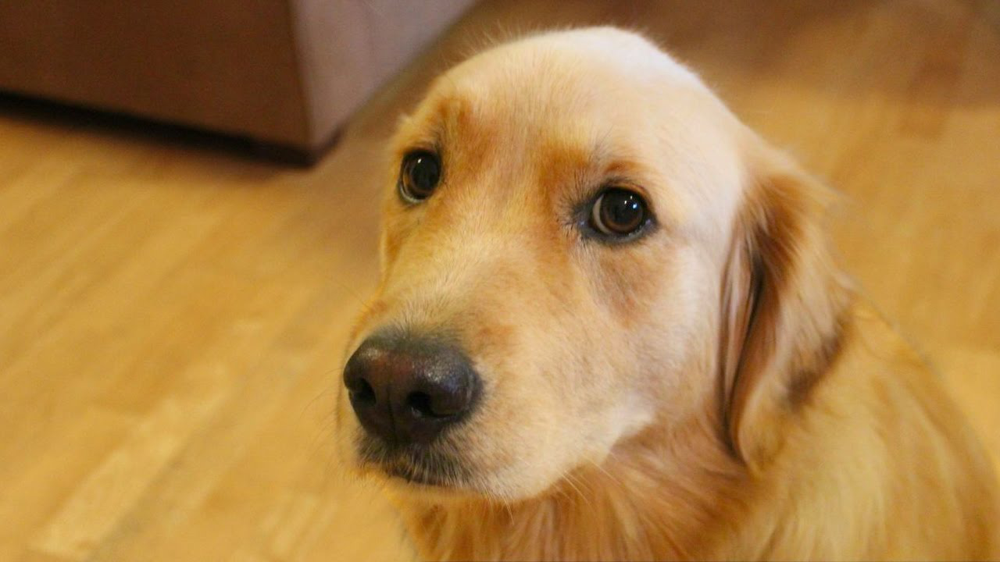

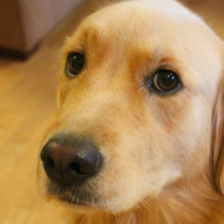

golden retriever



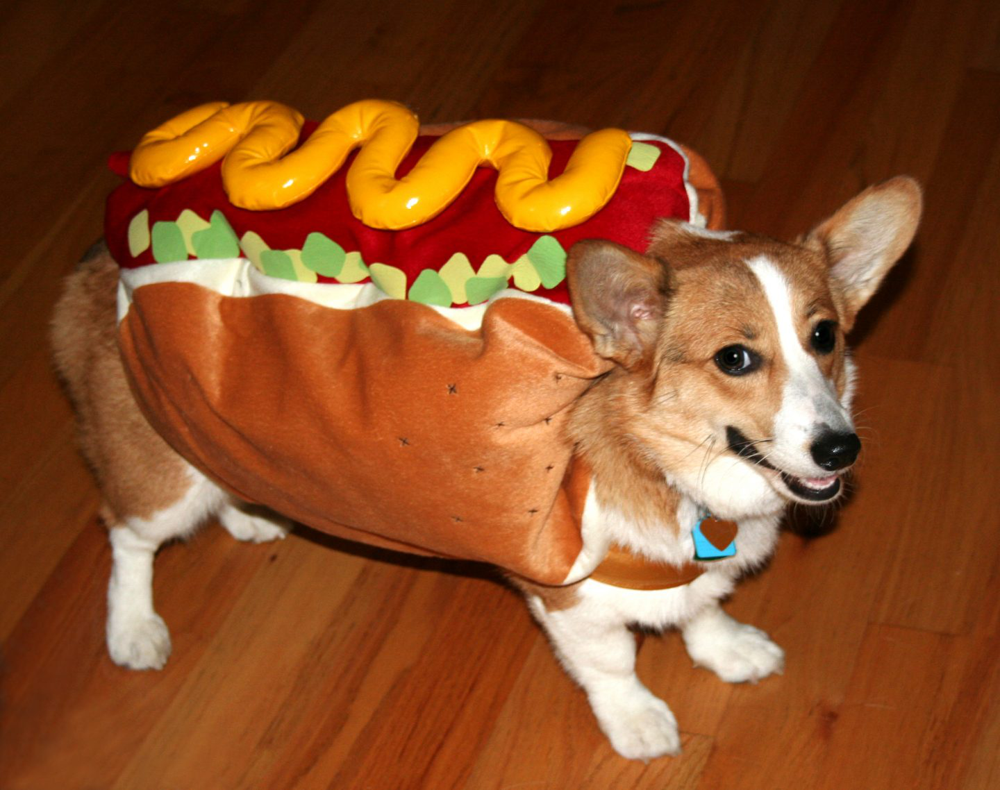

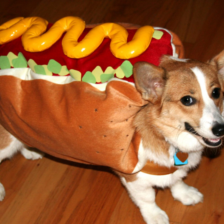

Cardigan, Cardigan Welsh corgi



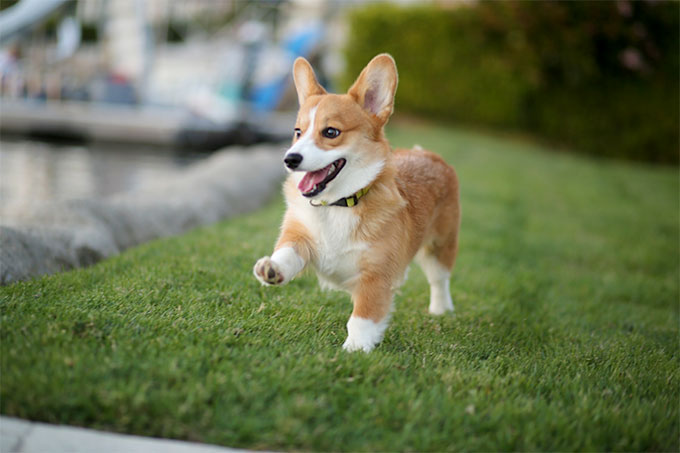

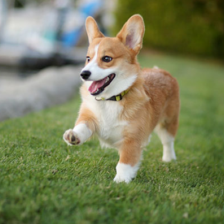

Pembroke, Pembroke Welsh corgi



In [20]:
for fp in Path('data/dogs/').glob('*.jpg'):
    ir = ImageRecognizer(fp)
    ir.show()
    print(ir.classify())

# Image Generation

In [21]:
import torch
import torch.nn as nn

class ResNetBlock(nn.Module):
    def __init__(self, dim):
        super(ResNetBlock, self).__init__()
        self.conv_block = self.build_conv_block(dim)
        
    def build_conv_block(self, dim):
        conv_block = []
        conv_block += [nn.ReflectionPad2d(1)]
        conv_block += [nn.Conv2d(dim, dim, kernel_size=3, padding=0, bias=True),
                      nn.InstanceNorm2d(dim),
                      nn.ReLU(True)]
        conv_block += [nn.ReflectionPad2d(1)]
        conv_block += [nn.Conv2d(dim, dim, kernel_size=3, padding=0, bias=True),
                      nn.InstanceNorm2d(dim)]
        return nn.Sequential(*conv_block)
    
    def forward(self, x):
        out = x + self.conv_block(x)
        return out
    

class ResNetGenerator(nn.Module):
    def __init__(self, input_nc=3, output_nc=3, ngf=64, n_blocks=9):
        assert(n_blocks >= 0)
        super(ResNetGenerator, self).__init__()
        
        self.input_nc = input_nc
        self.output_nc = output_nc
        self.ngf = ngf
        
        model = [nn.ReflectionPad2d(3),
                nn.Conv2d(input_nc, ngf, kernel_size=7, padding=0, bias=True),
                nn.InstanceNorm2d(ngf),
                nn.ReLU(True)]
        
        n_downsampling = 2
        for i in range(n_downsampling):
            mult = 2**i
            model += [nn.Conv2d(ngf * mult, ngf * mult * 2, kernel_size=3,
                               stride=2, padding=1, bias=True),
                     nn.InstanceNorm2d(ngf * mult / 2),
                     nn.ReLU(True)]
        
        mult = 2**n_downsampling
        for i in range(n_blocks):
            model += [ResNetBlock(ngf * mult)]
            
        for i in range(n_downsampling):
            mult = 2**(n_downsampling - i)
            model += [nn.ConvTranspose2d(ngf * mult, int(ngf * mult / 2),
                                        kernel_size=3, stride=2,
                                        padding=1, output_padding=1,
                                        bias=True),
                     nn.InstanceNorm2d(int(ngf * mult / 2)),
                     nn.ReLU(True)]
        
        model += [nn.ReflectionPad2d(3)]
        model += [nn.Conv2d(ngf, output_nc, kernel_size=7, padding=0)]
        model += [nn.Tanh()]
        
        self.model = nn.Sequential(*model)
        
    def forward(self, input):
        return self.model(input)

In [22]:
netG = ResNetGenerator()

In [23]:
model_path = 'data/horse2zebra_0.4.0.pth'
netG.load_state_dict(torch.load(model_path))

In [24]:
netG.eval()

ResNetGenerator(
  (model): Sequential(
    (0): ReflectionPad2d((3, 3, 3, 3))
    (1): Conv2d(3, 64, kernel_size=(7, 7), stride=(1, 1))
    (2): InstanceNorm2d(64, eps=1e-05, momentum=0.1, affine=False, track_running_stats=False)
    (3): ReLU(inplace)
    (4): Conv2d(64, 128, kernel_size=(3, 3), stride=(2, 2), padding=(1, 1))
    (5): InstanceNorm2d(32.0, eps=1e-05, momentum=0.1, affine=False, track_running_stats=False)
    (6): ReLU(inplace)
    (7): Conv2d(128, 256, kernel_size=(3, 3), stride=(2, 2), padding=(1, 1))
    (8): InstanceNorm2d(64.0, eps=1e-05, momentum=0.1, affine=False, track_running_stats=False)
    (9): ReLU(inplace)
    (10): ResNetBlock(
      (conv_block): Sequential(
        (0): ReflectionPad2d((1, 1, 1, 1))
        (1): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1))
        (2): InstanceNorm2d(256, eps=1e-05, momentum=0.1, affine=False, track_running_stats=False)
        (3): ReLU(inplace)
        (4): ReflectionPad2d((1, 1, 1, 1))
        (5): Conv2d(256

In [25]:
gan_preprocess = transforms.Compose([transforms.Resize(256),
                                    transforms.ToTensor()])

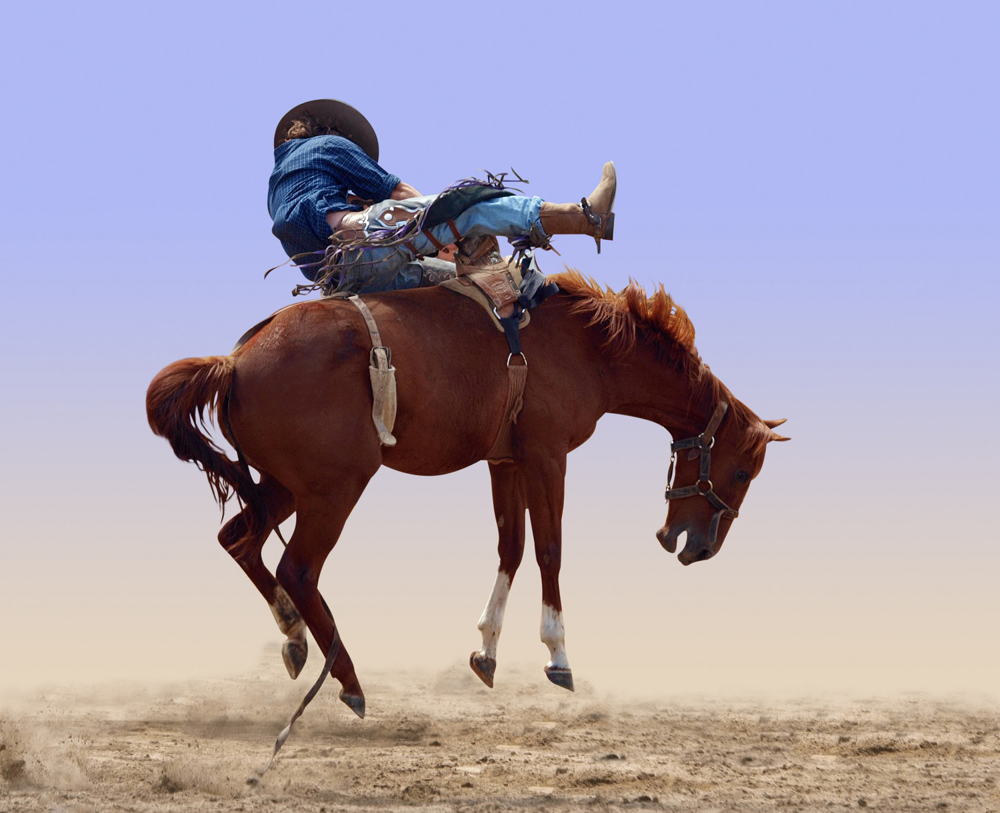

In [26]:
img = Image.open("data/horses/rodeo-horse.jpg")
img

In [27]:
img_t = gan_preprocess(img)
batch_t = torch.unsqueeze(img_t, 0)

In [28]:
batch_out = netG(batch_t)

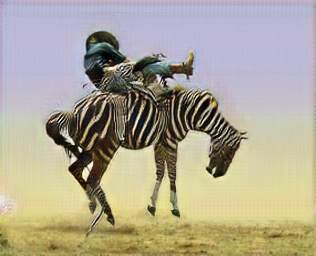

In [29]:
out_t = (batch_out.data.squeeze() + 1.0) / 2.0
out_img = transforms.ToPILImage()(out_t)
out_img

In [30]:
class Zebraify:
    netG = ResNetGenerator()
    model_path = 'data/horse2zebra_0.4.0.pth'
    netG.load_state_dict(torch.load(model_path))
    netG.eval()
    
    preprocess = transforms.Compose([transforms.Resize(256),
                                     transforms.ToTensor()])
    def __init__(self, fp: Path):
        self.img = Image.open(str(fp))
        
    def show(self) -> None:
        display(self.img)
        
    def replace(self) -> None:
        img_t = Zebraify.preprocess(self.img)
        batch_t = torch.unsqueeze(img_t, 0)
        batch_out = netG(batch_t)
        out_t = (batch_out.data.squeeze() + 1.0) / 2.0
        out_img = transforms.ToPILImage()(out_t)
        display(out_img)

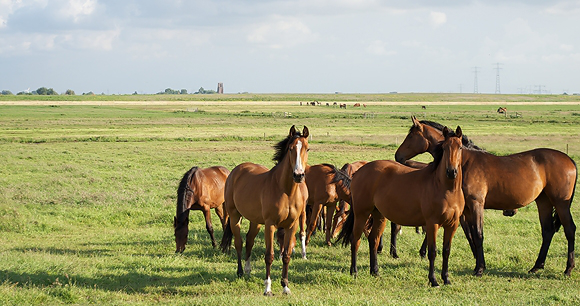

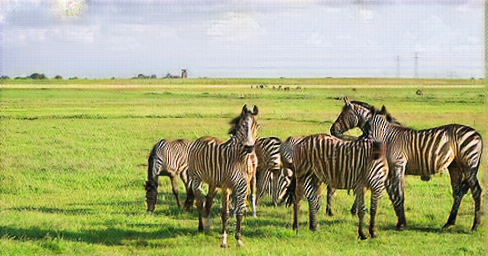

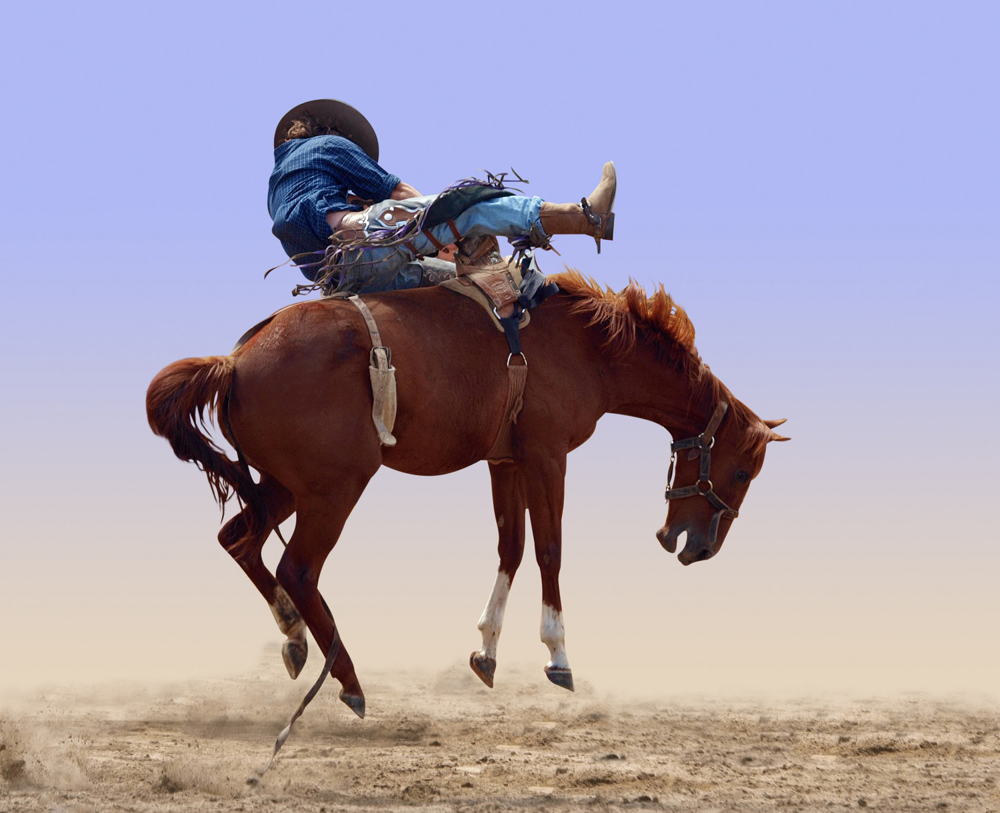

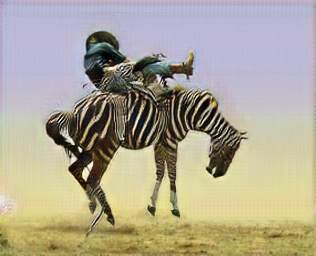

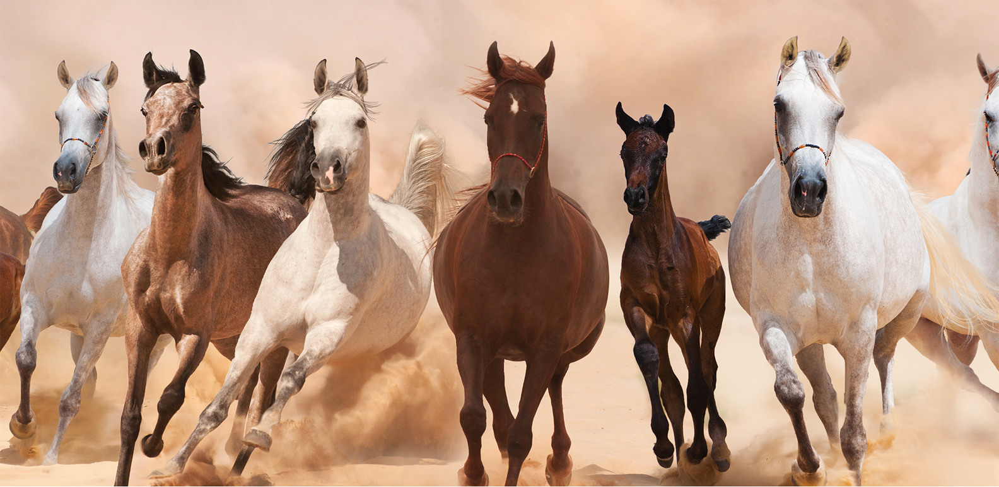

...

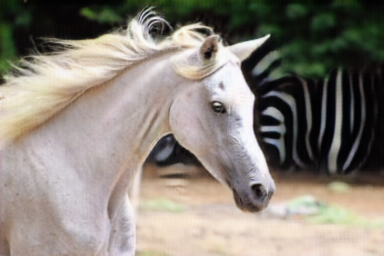

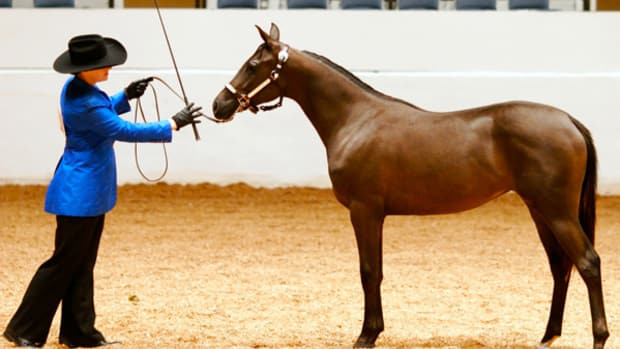

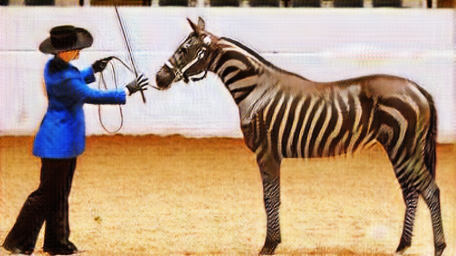

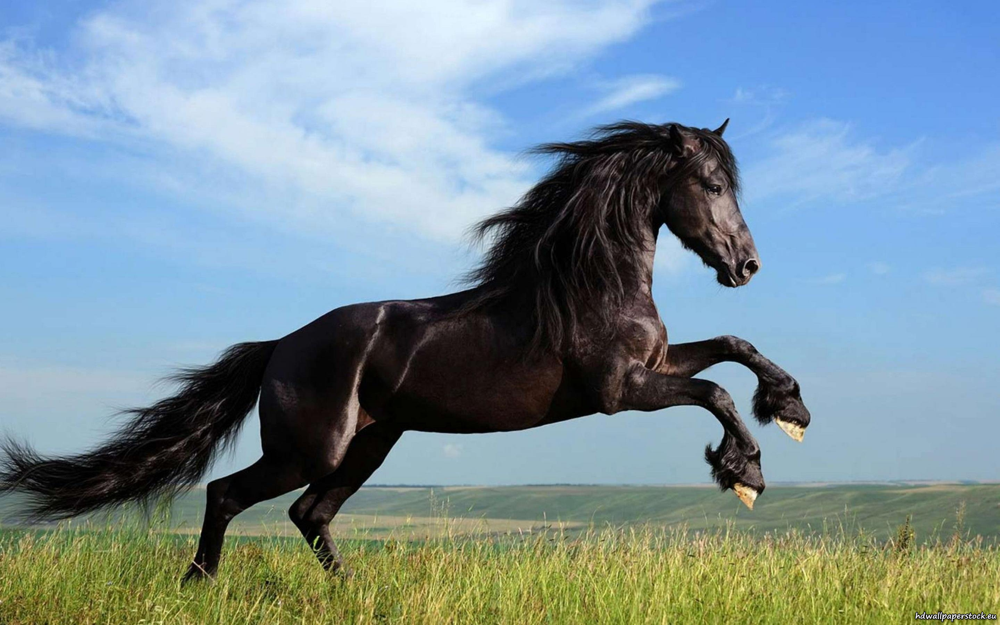

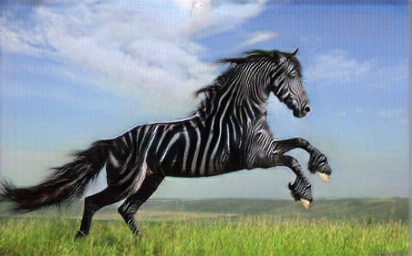

In [31]:
for fp in Path('data/horses/').glob('*.jpg'):
    z = Zebraify(fp)
    z.show()
    z.replace()

# Training MNIST with PyTorch

In [32]:
import torch
import torch.nn as nn
import torch.nn.functional as F
import torch.optim as optim
from torchvision import datasets, transforms
from torch.autograd import Variable


torch.manual_seed(4242)
train_loader = torch.utils.data.DataLoader(
    datasets.MNIST('cached_data/mnist', train=True, download=True,
                   transform=transforms.Compose([
                       transforms.ToTensor(),
                       transforms.Normalize((0.1307,), (0.3081,))
                   ])),
    batch_size=64, shuffle=True)

Processing...
Done!


In [33]:
class Net(nn.Module):
    def __init__(self):
        super(Net, self).__init__()
        self.conv1 = nn.Conv2d(1, 10, kernel_size=5)
        self.conv2 = nn.Conv2d(10, 20, kernel_size=5)
        self.conv2_drop = nn.Dropout2d()
        self.fc1 = nn.Linear(320, 50)
        self.fc2 = nn.Linear(50, 10)
    
    def forward(self, x):
        x = F.relu(F.max_pool2d(self.conv1(x), 2))
        x = F.relu(F.max_pool2d(self.conv2_drop(self.conv2(x)), 2))
        x = x.view(-1, 320)
        x = F.relu(self.fc1(x))
        x = F.dropout(x, training=self.training)
        x = self.fc2(x)
        return F.log_softmax(x, dim=1)

In [34]:
model = Net()

In [35]:
optimizer = optim.SGD(model.parameters(), lr=0.01, momentum=0.5)

In [36]:
for epoch in range(10):
    for batch_idx, (data, target) in enumerate(train_loader):
        data, target = Variable(data), Variable(target)
        optimizer.zero_grad()
        output = model(data)
        loss = F.nll_loss(output, target)
        print("Current loss", loss.item())
        loss.backward()
        optimizer.step()

Current loss 2.3338851928710938
Current loss 2.3198091983795166
Current loss 2.256340742111206
Current loss 2.2933189868927
Current loss 2.3249053955078125
Current loss 2.3071072101593018
Current loss 2.274592638015747
Current loss 2.3135533332824707
Current loss 2.3166332244873047
Current loss 2.2975008487701416
Current loss 2.279297351837158
Current loss 2.3031809329986572
Current loss 2.2796974182128906
Current loss 2.2454824447631836
Current loss 2.244527578353882
Current loss 2.288484811782837
Current loss 2.29500675201416
Current loss 2.244894504547119
Current loss 2.301905870437622
Current loss 2.250056266784668
Current loss 2.2356603145599365
Current loss 2.2633605003356934
Current loss 2.29990553855896
Current loss 2.2180750370025635
Current loss 2.2608790397644043
Current loss 2.2219607830047607
Current loss 2.2763426303863525
Current loss 2.2319672107696533
Current loss 2.2297346591949463
Current loss 2.2649128437042236
Current loss 2.2551841735839844
Current loss 2.25326371

Current loss 1.0149434804916382
Current loss 1.0091973543167114
Current loss 0.8571271300315857
Current loss 0.8134475946426392
Current loss 0.99644535779953
Current loss 1.077959656715393
Current loss 0.8956056237220764
Current loss 0.7656391263008118
Current loss 0.7666366696357727
Current loss 0.9282448291778564
Current loss 0.7747100591659546
Current loss 0.8986325263977051
Current loss 0.6776572465896606
Current loss 0.8493763208389282
Current loss 0.7353871464729309
Current loss 0.9300184845924377
Current loss 0.9616090059280396
Current loss 0.8260455131530762
Current loss 0.9679625034332275
Current loss 0.9113579988479614
Current loss 0.8360752463340759
Current loss 1.063362717628479
Current loss 0.9856603145599365
Current loss 0.8666471838951111
Current loss 0.7216979265213013
Current loss 0.7427721619606018
Current loss 0.7959009408950806
Current loss 0.7772163152694702
Current loss 0.9001716375350952
Current loss 0.6845651268959045
Current loss 0.7962489724159241
Current loss

Current loss 0.7261534333229065
Current loss 0.6136183142662048
Current loss 0.7418501973152161
Current loss 0.5947204232215881
Current loss 0.5662679672241211
Current loss 0.5865728259086609
Current loss 0.6417631506919861
Current loss 0.7323994040489197
Current loss 0.6428978443145752
Current loss 0.4822733700275421
Current loss 0.7126351594924927
Current loss 0.5369908809661865
Current loss 0.4831085205078125
Current loss 0.49361756443977356
Current loss 0.91218501329422
Current loss 0.8064146637916565
Current loss 0.49463310837745667
Current loss 0.5700938701629639
Current loss 0.6724141836166382
Current loss 0.5504088401794434
Current loss 0.7909526228904724
Current loss 0.653852641582489
Current loss 0.567493200302124
Current loss 0.7205783128738403
Current loss 0.49755963683128357
Current loss 0.6559883952140808
Current loss 0.41976651549339294
Current loss 0.5514209866523743
Current loss 0.6740803718566895
Current loss 0.5386719703674316
Current loss 0.46153053641319275
Current

Current loss 0.6854788064956665
Current loss 0.6998356580734253
Current loss 0.6096978187561035
Current loss 0.45818349719047546
Current loss 0.5491428375244141
Current loss 0.37634947896003723
Current loss 0.4862692356109619
Current loss 0.5380047559738159
Current loss 0.6078855395317078
Current loss 0.459652304649353
Current loss 0.4272531270980835
Current loss 0.3139541447162628
Current loss 0.6375546455383301
Current loss 0.4201100170612335
Current loss 0.5189412236213684
Current loss 0.41602420806884766
Current loss 0.4571863114833832
Current loss 0.3179832696914673
Current loss 0.3408733606338501
Current loss 0.6527051329612732
Current loss 0.5658093094825745
Current loss 0.42474472522735596
Current loss 0.36363664269447327
Current loss 0.5033568143844604
Current loss 0.42099714279174805
Current loss 0.4480014741420746
Current loss 0.5216115117073059
Current loss 0.33427000045776367
Current loss 0.38542667031288147
Current loss 0.530944287776947
Current loss 0.5106062293052673
Cu

Current loss 0.5638736486434937
Current loss 0.556038498878479
Current loss 0.39956554770469666
Current loss 0.3579796552658081
Current loss 0.2832973003387451
Current loss 0.5235812067985535
Current loss 0.39241331815719604
Current loss 0.4425559639930725
Current loss 0.24637186527252197
Current loss 0.3587152361869812
Current loss 0.40905824303627014
Current loss 0.2885458469390869
Current loss 0.40145695209503174
Current loss 0.42306143045425415
Current loss 0.5295829772949219
Current loss 0.4413868486881256
Current loss 0.5525141954421997
Current loss 0.3129170536994934
Current loss 0.22881163656711578
Current loss 0.4093978703022003
Current loss 0.4154719114303589
Current loss 0.4079543650150299
Current loss 0.4990907907485962
Current loss 0.48409828543663025
Current loss 0.8856423497200012
Current loss 0.4338386058807373
Current loss 0.28278741240501404
Current loss 0.5325320959091187
Current loss 0.40037694573402405
Current loss 0.3977429270744324
Current loss 0.7185050249099731

Current loss 0.7076675295829773
Current loss 0.3118892014026642
Current loss 0.2967470586299896
Current loss 0.41841399669647217
Current loss 0.2260776162147522
Current loss 0.5031570196151733
Current loss 0.2955310046672821
Current loss 0.2859960198402405
Current loss 0.488300085067749
Current loss 0.5073145627975464
Current loss 0.32053977251052856
Current loss 0.35626712441444397
Current loss 0.3861200213432312
Current loss 0.5929203033447266
Current loss 0.35613518953323364
Current loss 0.3957369923591614
Current loss 0.5112440586090088
Current loss 0.23491421341896057
Current loss 0.49246683716773987
Current loss 0.42647385597229004
Current loss 0.39777126908302307
Current loss 0.43074920773506165
Current loss 0.21801002323627472
Current loss 0.5764386057853699
Current loss 0.2806470990180969
Current loss 0.3175230622291565
Current loss 0.29887905716896057
Current loss 0.43292003870010376
Current loss 0.27334070205688477
Current loss 0.3710881173610687
Current loss 0.5190684795379

Current loss 0.3683943748474121
Current loss 0.4072321653366089
Current loss 0.4049239456653595
Current loss 0.453514039516449
Current loss 0.37524694204330444
Current loss 0.41771143674850464
Current loss 0.3131029009819031
Current loss 0.42601874470710754
Current loss 0.3354620635509491
Current loss 0.3379535973072052
Current loss 0.5043256282806396
Current loss 0.4922522306442261
Current loss 0.41083604097366333
Current loss 0.36742812395095825
Current loss 0.18327781558036804
Current loss 0.36942362785339355
Current loss 0.36914002895355225
Current loss 0.2817018926143646
Current loss 0.43431809544563293
Current loss 0.2425563484430313
Current loss 0.47370076179504395
Current loss 0.22336865961551666
Current loss 0.24449419975280762
Current loss 0.4974898099899292
Current loss 0.33424022793769836
Current loss 0.39185383915901184
Current loss 0.3295563757419586
Current loss 0.24775372445583344
Current loss 0.4839838147163391
Current loss 0.27675390243530273
Current loss 0.3763222396

Current loss 0.3420222997665405
Current loss 0.31850069761276245
Current loss 0.3087617754936218
Current loss 0.3654969334602356
Current loss 0.609011173248291
Current loss 0.3537031412124634
Current loss 0.3270866870880127
Current loss 0.25474512577056885
Current loss 0.22928284108638763
Current loss 0.3603992760181427
Current loss 0.3077315092086792
Current loss 0.3061983585357666
Current loss 0.3255927562713623
Current loss 0.327224463224411
Current loss 0.4878690838813782
Current loss 0.2789144515991211
Current loss 0.1319546401500702
Current loss 0.19203275442123413
Current loss 0.30797079205513
Current loss 0.3050147593021393
Current loss 0.35429486632347107
Current loss 0.34547507762908936
Current loss 0.214954674243927
Current loss 0.26008808612823486
Current loss 0.29660552740097046
Current loss 0.17592310905456543
Current loss 0.5144615173339844
Current loss 0.25243037939071655
Current loss 0.3484360873699188
Current loss 0.40197837352752686
Current loss 0.42044076323509216
C

Current loss 0.3921905755996704
Current loss 0.4256404638290405
Current loss 0.19241924583911896
Current loss 0.24119716882705688
Current loss 0.5716381669044495
Current loss 0.34304699301719666
Current loss 0.20034974813461304
Current loss 0.2630128264427185
Current loss 0.5349116921424866
Current loss 0.2731890380382538
Current loss 0.22188490629196167
Current loss 0.2055187076330185
Current loss 0.5424187779426575
Current loss 0.3890155851840973
Current loss 0.5038480758666992
Current loss 0.3736320436000824
Current loss 0.11948436498641968
Current loss 0.2593933045864105
Current loss 0.3553328216075897
Current loss 0.35442692041397095
Current loss 0.32155540585517883
Current loss 0.37079644203186035
Current loss 0.3357386887073517
Current loss 0.3331186771392822
Current loss 0.4657934606075287
Current loss 0.37174883484840393
Current loss 0.22175762057304382
Current loss 0.27582672238349915
Current loss 0.41257452964782715
Current loss 0.23078805208206177
Current loss 0.35485929250

Current loss 0.26075810194015503
Current loss 0.29131659865379333
Current loss 0.18454453349113464
Current loss 0.3331194818019867
Current loss 0.4291679263114929
Current loss 0.40663009881973267
Current loss 0.23734435439109802
Current loss 0.3442124128341675
Current loss 0.1946181356906891
Current loss 0.22663605213165283
Current loss 0.18048912286758423
Current loss 0.3301195204257965
Current loss 0.38630348443984985
Current loss 0.1994151920080185
Current loss 0.26696088910102844
Current loss 0.24008655548095703
Current loss 0.2923377752304077
Current loss 0.23425471782684326
Current loss 0.17750349640846252
Current loss 0.36160504817962646
Current loss 0.3207724690437317
Current loss 0.17240716516971588
Current loss 0.20186501741409302
Current loss 0.33944663405418396
Current loss 0.29564574360847473
Current loss 0.5405222773551941
Current loss 0.21279901266098022
Current loss 0.40704524517059326
Current loss 0.35570114850997925
Current loss 0.45598864555358887
Current loss 0.2242

Current loss 0.2565283477306366
Current loss 0.15873870253562927
Current loss 0.315852552652359
Current loss 0.7331317663192749
Current loss 0.17528381943702698
Current loss 0.28291356563568115
Current loss 0.49574536085128784
Current loss 0.14567787945270538
Current loss 0.28744375705718994
Current loss 0.2922540009021759
Current loss 0.3684864342212677
Current loss 0.27486494183540344
Current loss 0.39172250032424927
Current loss 0.3367123603820801
Current loss 0.3210929334163666
Current loss 0.1627344787120819
Current loss 0.4266687035560608
Current loss 0.2275146096944809
Current loss 0.18188154697418213
Current loss 0.21127773821353912
Current loss 0.3397985100746155
Current loss 0.2486865520477295
Current loss 0.31382110714912415
Current loss 0.10704511404037476
Current loss 0.20878125727176666
Current loss 0.2658241391181946
Current loss 0.2341427057981491
Current loss 0.29465633630752563
Current loss 0.21410410106182098
Current loss 0.24923966825008392
Current loss 0.3651499450

Current loss 0.4544076919555664
Current loss 0.43023189902305603
Current loss 0.3053712844848633
Current loss 0.21518252789974213
Current loss 0.29630282521247864
Current loss 0.38467171788215637
Current loss 0.48932158946990967
Current loss 0.34129321575164795
Current loss 0.3044957220554352
Current loss 0.16766546666622162
Current loss 0.26035499572753906
Current loss 0.23414117097854614
Current loss 0.16844750940799713
Current loss 0.2991151511669159
Current loss 0.1987985074520111
Current loss 0.32230663299560547
Current loss 0.2713760435581207
Current loss 0.1833055317401886
Current loss 0.34779220819473267
Current loss 0.10168494284152985
Current loss 0.2838975489139557
Current loss 0.2929745018482208
Current loss 0.20696546137332916
Current loss 0.3246760368347168
Current loss 0.45354241132736206
Current loss 0.2589307427406311
Current loss 0.2691008746623993
Current loss 0.18102262914180756
Current loss 0.3543466329574585
Current loss 0.20994265377521515
Current loss 0.24562519

Current loss 0.22464613616466522
Current loss 0.15013396739959717
Current loss 0.2831140458583832
Current loss 0.32891252636909485
Current loss 0.3419645130634308
Current loss 0.15730886161327362
Current loss 0.11951129138469696
Current loss 0.33227473497390747
Current loss 0.24669073522090912
Current loss 0.18787117302417755
Current loss 0.34655049443244934
Current loss 0.4357558488845825
Current loss 0.38394662737846375
Current loss 0.5785139799118042
Current loss 0.11391513794660568
Current loss 0.29498887062072754
Current loss 0.11443822085857391
Current loss 0.24651019275188446
Current loss 0.2815372049808502
Current loss 0.33068057894706726
Current loss 0.17409327626228333
Current loss 0.3820616602897644
Current loss 0.22129392623901367
Current loss 0.5194387435913086
Current loss 0.11467427015304565
Current loss 0.22625848650932312
Current loss 0.32240989804267883
Current loss 0.39529404044151306
Current loss 0.1988791972398758
Current loss 0.23419927060604095
Current loss 0.245

Current loss 0.18868409097194672
Current loss 0.14406953752040863
Current loss 0.12822747230529785
Current loss 0.15535913407802582
Current loss 0.23333440721035004
Current loss 0.291495680809021
Current loss 0.1749596744775772
Current loss 0.14016951620578766
Current loss 0.2260892242193222
Current loss 0.23653468489646912
Current loss 0.3746984899044037
Current loss 0.17394006252288818
Current loss 0.1895524114370346
Current loss 0.2866608798503876
Current loss 0.12860015034675598
Current loss 0.5849962830543518
Current loss 0.2717342674732208
Current loss 0.23974661529064178
Current loss 0.3534666895866394
Current loss 0.13749028742313385
Current loss 0.17727667093276978
Current loss 0.20427069067955017
Current loss 0.16536062955856323
Current loss 0.3606076240539551
Current loss 0.3261772096157074
Current loss 0.18783339858055115
Current loss 0.539228618144989
Current loss 0.2417474389076233
Current loss 0.24113918840885162
Current loss 0.14879532158374786
Current loss 0.1661532223

Current loss 0.3261086940765381
Current loss 0.3307362198829651
Current loss 0.14985309541225433
Current loss 0.24012336134910583
Current loss 0.268231064081192
Current loss 0.17537085711956024
Current loss 0.31953224539756775
Current loss 0.21848291158676147
Current loss 0.14260612428188324
Current loss 0.20576263964176178
Current loss 0.1883734166622162
Current loss 0.24837739765644073
Current loss 0.16634590923786163
Current loss 0.30634382367134094
Current loss 0.22624364495277405
Current loss 0.1634458601474762
Current loss 0.28707003593444824
Current loss 0.18984650075435638
Current loss 0.8840216994285583
Current loss 0.2490009069442749
Current loss 0.28234755992889404
Current loss 0.534452497959137
Current loss 0.49020007252693176
Current loss 0.3217054307460785
Current loss 0.3894033432006836
Current loss 0.34696677327156067
Current loss 0.332735538482666
Current loss 0.23747901618480682
Current loss 0.2735651731491089
Current loss 0.15621472895145416
Current loss 0.1582400351

Current loss 0.2514299750328064
Current loss 0.2543225884437561
Current loss 0.20468822121620178
Current loss 0.23270921409130096
Current loss 0.23599587380886078
Current loss 0.16818706691265106
Current loss 0.21866992115974426
Current loss 0.2336922436952591
Current loss 0.06560350209474564
Current loss 0.17900888621807098
Current loss 0.18567413091659546
Current loss 0.19188013672828674
Current loss 0.14336825907230377
Current loss 0.12426552176475525
Current loss 0.16702519357204437
Current loss 0.13866040110588074
Current loss 0.18576250970363617
Current loss 0.2026752084493637
Current loss 0.3417551815509796
Current loss 0.196999192237854
Current loss 0.3482685685157776
Current loss 0.5189734101295471
Current loss 0.1342991143465042
Current loss 0.12558308243751526
Current loss 0.23586437106132507
Current loss 0.23053601384162903
Current loss 0.16097448766231537
Current loss 0.21151474118232727
Current loss 0.2686755061149597
Current loss 0.15292005240917206
Current loss 0.306120

Current loss 0.14065079391002655
Current loss 0.4986763596534729
Current loss 0.3287515938282013
Current loss 0.1991804540157318
Current loss 0.20980297029018402
Current loss 0.11123128980398178
Current loss 0.21362701058387756
Current loss 0.12518510222434998
Current loss 0.49325278401374817
Current loss 0.1452798992395401
Current loss 0.10725964605808258
Current loss 0.20525503158569336
Current loss 0.11562728881835938
Current loss 0.19697712361812592
Current loss 0.20365393161773682
Current loss 0.26487332582473755
Current loss 0.180853009223938
Current loss 0.16049699485301971
Current loss 0.12610915303230286
Current loss 0.1490638107061386
Current loss 0.07462337613105774
Current loss 0.23446905612945557
Current loss 0.13009750843048096
Current loss 0.24224039912223816
Current loss 0.14256183803081512
Current loss 0.5587634444236755
Current loss 0.24852107465267181
Current loss 0.2666029930114746
Current loss 0.41245725750923157
Current loss 0.24002231657505035
Current loss 0.4218

Current loss 0.4709409475326538
Current loss 0.29415765404701233
Current loss 0.20639726519584656
Current loss 0.17771266400814056
Current loss 0.38895243406295776
Current loss 0.27679944038391113
Current loss 0.3624400496482849
Current loss 0.2402908205986023
Current loss 0.31151601672172546
Current loss 0.17695268988609314
Current loss 0.26556649804115295
Current loss 0.1774669736623764
Current loss 0.1606505960226059
Current loss 0.37507960200309753
Current loss 0.20593927800655365
Current loss 0.2144637107849121
Current loss 0.19101835787296295
Current loss 0.34582099318504333
Current loss 0.1823195219039917
Current loss 0.14131949841976166
Current loss 0.15140491724014282
Current loss 0.32602643966674805
Current loss 0.099541075527668
Current loss 0.20437580347061157
Current loss 0.13678483664989471
Current loss 0.06254834681749344
Current loss 0.156230166554451
Current loss 0.15241985023021698
Current loss 0.3051769733428955
Current loss 0.15225258469581604
Current loss 0.1264935

Current loss 0.30849120020866394
Current loss 0.20695644617080688
Current loss 0.1678045690059662
Current loss 0.2523365616798401
Current loss 0.16649256646633148
Current loss 0.334600567817688
Current loss 0.21058495342731476
Current loss 0.21372167766094208
Current loss 0.34380513429641724
Current loss 0.12997378408908844
Current loss 0.28223076462745667
Current loss 0.23665611445903778
Current loss 0.12513518333435059
Current loss 0.11361818760633469
Current loss 0.2990349233150482
Current loss 0.4223785996437073
Current loss 0.21011795103549957
Current loss 0.26078203320503235
Current loss 0.13284355401992798
Current loss 0.29892802238464355
Current loss 0.2749197483062744
Current loss 0.24341587722301483
Current loss 0.13152635097503662
Current loss 0.14754679799079895
Current loss 0.21408647298812866
Current loss 0.08534421771764755
Current loss 0.08317219465970993
Current loss 0.15681032836437225
Current loss 0.3205745220184326
Current loss 0.15255792438983917
Current loss 0.185

Current loss 0.1758207380771637
Current loss 0.12309654802083969
Current loss 0.11434099823236465
Current loss 0.19204239547252655
Current loss 0.2004270702600479
Current loss 0.33124324679374695
Current loss 0.19509251415729523
Current loss 0.19227929413318634
Current loss 0.20739296078681946
Current loss 0.20803727209568024
Current loss 0.10732556879520416
Current loss 0.1215660572052002
Current loss 0.19081181287765503
Current loss 0.061113618314266205
Current loss 0.12026575207710266
Current loss 0.17699222266674042
Current loss 0.10744507610797882
Current loss 0.15305349230766296
Current loss 0.21333998441696167
Current loss 0.1847090870141983
Current loss 0.12020176649093628
Current loss 0.277668297290802
Current loss 0.24035751819610596
Current loss 0.32145947217941284
Current loss 0.2847975492477417
Current loss 0.32877835631370544
Current loss 0.16305910050868988
Current loss 0.19344130158424377
Current loss 0.12821774184703827
Current loss 0.20339426398277283
Current loss 0.3

Current loss 0.14027634263038635
Current loss 0.18018771708011627
Current loss 0.051394835114479065
Current loss 0.21379157900810242
Current loss 0.125251904129982
Current loss 0.18696904182434082
Current loss 0.11496897041797638
Current loss 0.12511657178401947
Current loss 0.20621244609355927
Current loss 0.42271673679351807
Current loss 0.19314737617969513
Current loss 0.1647714525461197
Current loss 0.20523594319820404
Current loss 0.12379088997840881
Current loss 0.17863932251930237
Current loss 0.22365540266036987
Current loss 0.20419803261756897
Current loss 0.1943022459745407
Current loss 0.17610576748847961
Current loss 0.29455873370170593
Current loss 0.19338363409042358
Current loss 0.15315213799476624
Current loss 0.12145501375198364
Current loss 0.18367137014865875
Current loss 0.272991418838501
Current loss 0.29974544048309326
Current loss 0.17355820536613464
Current loss 0.4186977744102478
Current loss 0.08335226029157639
Current loss 0.21692001819610596
Current loss 0.0

Current loss 0.25515618920326233
Current loss 0.19895564019680023
Current loss 0.3046102225780487
Current loss 0.4044811725616455
Current loss 0.21085937321186066
Current loss 0.3531915545463562
Current loss 0.15931296348571777
Current loss 0.12627999484539032
Current loss 0.06636154651641846
Current loss 0.14261017739772797
Current loss 0.19737161695957184
Current loss 0.07012939453125
Current loss 0.10780993849039078
Current loss 0.14625491201877594
Current loss 0.18368560075759888
Current loss 0.1750396341085434
Current loss 0.5275242924690247
Current loss 0.18478667736053467
Current loss 0.3604622483253479
Current loss 0.28277283906936646
Current loss 0.2977571189403534
Current loss 0.19073469936847687
Current loss 0.3441791534423828
Current loss 0.179899662733078
Current loss 0.294590562582016
Current loss 0.12160898745059967
Current loss 0.216168612241745
Current loss 0.19955779612064362
Current loss 0.09373295307159424
Current loss 0.06949672847986221
Current loss 0.307891726493

Current loss 0.14121827483177185
Current loss 0.12005497515201569
Current loss 0.4047311842441559
Current loss 0.09553024917840958
Current loss 0.21107985079288483
Current loss 0.10362531989812851
Current loss 0.19665023684501648
Current loss 0.49584636092185974
Current loss 0.05172703042626381
Current loss 0.12243425846099854
Current loss 0.2296231985092163
Current loss 0.23063352704048157
Current loss 0.1983424574136734
Current loss 0.22398556768894196
Current loss 0.09454228729009628
Current loss 0.12177619338035583
Current loss 0.2045440822839737
Current loss 0.13326874375343323
Current loss 0.11362998932600021
Current loss 0.3645327091217041
Current loss 0.22743134200572968
Current loss 0.20631739497184753
Current loss 0.16983799636363983
Current loss 0.2614278793334961
Current loss 0.24460189044475555
Current loss 0.16476790606975555
Current loss 0.10348136723041534
Current loss 0.21042391657829285
Current loss 0.1696479320526123
Current loss 0.13096219301223755
Current loss 0.36

Current loss 0.16800937056541443
Current loss 0.21114222705364227
Current loss 0.17662516236305237
Current loss 0.19598138332366943
Current loss 0.394387811422348
Current loss 0.20927976071834564
Current loss 0.08352021872997284
Current loss 0.05680917203426361
Current loss 0.18457958102226257
Current loss 0.1586383730173111
Current loss 0.12079323083162308
Current loss 0.31731534004211426
Current loss 0.17442719638347626
Current loss 0.1790764182806015
Current loss 0.1016724482178688
Current loss 0.19071415066719055
Current loss 0.13342002034187317
Current loss 0.15603229403495789
Current loss 0.1828201711177826
Current loss 0.3374398946762085
Current loss 0.34173741936683655
Current loss 0.08759091049432755
Current loss 0.2071179300546646
Current loss 0.0967707633972168
Current loss 0.15881000459194183
Current loss 0.1511203944683075
Current loss 0.07576722651720047
Current loss 0.10625490546226501
Current loss 0.23465768992900848
Current loss 0.22788958251476288
Current loss 0.29917

Current loss 0.201341912150383
Current loss 0.34955620765686035
Current loss 0.15757715702056885
Current loss 0.16113176941871643
Current loss 0.1281326562166214
Current loss 0.2774827480316162
Current loss 0.2415245771408081
Current loss 0.408385306596756
Current loss 0.14738819003105164
Current loss 0.3030969500541687
Current loss 0.23731204867362976
Current loss 0.2323155254125595
Current loss 0.11852189153432846
Current loss 0.1991014927625656
Current loss 0.23526859283447266
Current loss 0.19405338168144226
Current loss 0.22761806845664978
Current loss 0.15883062779903412
Current loss 0.14334671199321747
Current loss 0.14899316430091858
Current loss 0.3233069181442261
Current loss 0.21930846571922302
Current loss 0.4278562366962433
Current loss 0.22155191004276276
Current loss 0.12516231834888458
Current loss 0.09876152127981186
Current loss 0.1389215886592865
Current loss 0.14558880031108856
Current loss 0.1897202730178833
Current loss 0.5541084408760071
Current loss 0.1297808289

Current loss 0.20767295360565186
Current loss 0.15211442112922668
Current loss 0.1730271428823471
Current loss 0.21948778629302979
Current loss 0.12727367877960205
Current loss 0.2864345610141754
Current loss 0.16211703419685364
Current loss 0.4837692379951477
Current loss 0.1710115224123001
Current loss 0.1597396433353424
Current loss 0.09136834740638733
Current loss 0.3199555575847626
Current loss 0.15542630851268768
Current loss 0.0956609845161438
Current loss 0.1621050238609314
Current loss 0.1978050023317337
Current loss 0.467759907245636
Current loss 0.11552363634109497
Current loss 0.15129272639751434
Current loss 0.07848965376615524
Current loss 0.31839218735694885
Current loss 0.14030276238918304
Current loss 0.3880569636821747
Current loss 0.1269296556711197
Current loss 0.14553292095661163
Current loss 0.1145397201180458
Current loss 0.16665849089622498
Current loss 0.1547020822763443
Current loss 0.3333994746208191
Current loss 0.21435846388339996
Current loss 0.18449839949

Current loss 0.19485023617744446
Current loss 0.13340602815151215
Current loss 0.16543829441070557
Current loss 0.2735328674316406
Current loss 0.1721329540014267
Current loss 0.13846246898174286
Current loss 0.21850033104419708
Current loss 0.13234810531139374
Current loss 0.18145130574703217
Current loss 0.07937189191579819
Current loss 0.32616323232650757
Current loss 0.1410917341709137
Current loss 0.14035016298294067
Current loss 0.31612902879714966
Current loss 0.3740297555923462
Current loss 0.30859559774398804
Current loss 0.16270694136619568
Current loss 0.1893709897994995
Current loss 0.18319402635097504
Current loss 0.2462824434041977
Current loss 0.12115583568811417
Current loss 0.2735474407672882
Current loss 0.10168121755123138
Current loss 0.16676324605941772
Current loss 0.1752832978963852
Current loss 0.11127974838018417
Current loss 0.13538247346878052
Current loss 0.13396628201007843
Current loss 0.10508036613464355
Current loss 0.13886374235153198
Current loss 0.210

Current loss 0.2964620888233185
Current loss 0.07235903292894363
Current loss 0.2786012291908264
Current loss 0.16197359561920166
Current loss 0.24532347917556763
Current loss 0.13880816102027893
Current loss 0.23713120818138123
Current loss 0.18734602630138397
Current loss 0.22015100717544556
Current loss 0.4286816716194153
Current loss 0.31185755133628845
Current loss 0.0966009721159935
Current loss 0.0760807916522026
Current loss 0.34221333265304565
Current loss 0.09485992789268494
Current loss 0.2212517112493515
Current loss 0.07410996407270432
Current loss 0.2704041302204132
Current loss 0.13401469588279724
Current loss 0.2707363963127136
Current loss 0.4217902719974518
Current loss 0.13417960703372955
Current loss 0.2188127636909485
Current loss 0.3958050608634949
Current loss 0.1372215896844864
Current loss 0.18185795843601227
Current loss 0.09740752726793289
Current loss 0.16029487550258636
Current loss 0.14819858968257904
Current loss 0.23090538382530212
Current loss 0.1623337

Current loss 0.16816696524620056
Current loss 0.1635269969701767
Current loss 0.04247017204761505
Current loss 0.29591697454452515
Current loss 0.2696409821510315
Current loss 0.15003558993339539
Current loss 0.4804070293903351
Current loss 0.0747445747256279
Current loss 0.1772305816411972
Current loss 0.3777076005935669
Current loss 0.1783341020345688
Current loss 0.25997981429100037
Current loss 0.22685398161411285
Current loss 0.15043576061725616
Current loss 0.2072666734457016
Current loss 0.17361299693584442
Current loss 0.30593615770339966
Current loss 0.15032683312892914
Current loss 0.1659742146730423
Current loss 0.16292856633663177
Current loss 0.236037477850914
Current loss 0.1876709908246994
Current loss 0.3535982668399811
Current loss 0.1934877634048462
Current loss 0.10283368825912476
Current loss 0.07224857807159424
Current loss 0.199129119515419
Current loss 0.08602944761514664
Current loss 0.15126292407512665
Current loss 0.10211504995822906
Current loss 0.19460323452

Current loss 0.12696444988250732
Current loss 0.13883572816848755
Current loss 0.15840618312358856
Current loss 0.14522621035575867
Current loss 0.07520685344934464
Current loss 0.14988259971141815
Current loss 0.18855290114879608
Current loss 0.15719759464263916
Current loss 0.165791317820549
Current loss 0.12289024889469147
Current loss 0.18667936325073242
Current loss 0.12845204770565033
Current loss 0.2772367000579834
Current loss 0.156052827835083
Current loss 0.23278479278087616
Current loss 0.29361990094184875
Current loss 0.12745624780654907
Current loss 0.12485788017511368
Current loss 0.11483730375766754
Current loss 0.16558516025543213
Current loss 0.32763734459877014
Current loss 0.04018404707312584
Current loss 0.19846978783607483
Current loss 0.11332480609416962
Current loss 0.19440530240535736
Current loss 0.11236785352230072
Current loss 0.20131435990333557
Current loss 0.08651207387447357
Current loss 0.21468937397003174
Current loss 0.09776763617992401
Current loss 0.

Current loss 0.23998653888702393
Current loss 0.1394561380147934
Current loss 0.1541547179222107
Current loss 0.19276019930839539
Current loss 0.19227348268032074
Current loss 0.12279687821865082
Current loss 0.07429114729166031
Current loss 0.10106687247753143
Current loss 0.2437339872121811
Current loss 0.21210846304893494
Current loss 0.08082345128059387
Current loss 0.20124022662639618
Current loss 0.26977401971817017
Current loss 0.08694528043270111
Current loss 0.21372495591640472
Current loss 0.2264101803302765
Current loss 0.1491098403930664
Current loss 0.04156967252492905
Current loss 0.08317863196134567
Current loss 0.1057828739285469
Current loss 0.14027562737464905
Current loss 0.272641658782959
Current loss 0.06903351843357086
Current loss 0.24691061675548553
Current loss 0.10192131996154785
Current loss 0.11762245744466782
Current loss 0.2682895064353943
Current loss 0.14951618015766144
Current loss 0.24507023394107819
Current loss 0.2445109486579895
Current loss 0.07293

Current loss 0.14366231858730316
Current loss 0.19317790865898132
Current loss 0.23161987960338593
Current loss 0.23364469408988953
Current loss 0.31148988008499146
Current loss 0.36299946904182434
Current loss 0.1012902781367302
Current loss 0.09197548031806946
Current loss 0.1796262562274933
Current loss 0.07945957034826279
Current loss 0.09914888441562653
Current loss 0.17894481122493744
Current loss 0.10534698516130447
Current loss 0.0941019356250763
Current loss 0.1362874060869217
Current loss 0.11559675633907318
Current loss 0.13069461286067963
Current loss 0.15882283449172974
Current loss 0.17216870188713074
Current loss 0.24911841750144958
Current loss 0.23914797604084015
Current loss 0.06993883848190308
Current loss 0.07632491737604141
Current loss 0.22852148115634918
Current loss 0.06527315825223923
Current loss 0.08268788456916809
Current loss 0.23403513431549072
Current loss 0.1858932226896286
Current loss 0.13079911470413208
Current loss 0.07610964775085449
Current loss 0.

Current loss 0.14820748567581177
Current loss 0.07219888269901276
Current loss 0.03559444099664688
Current loss 0.14164097607135773
Current loss 0.1003943607211113
Current loss 0.21370691061019897
Current loss 0.16439910233020782
Current loss 0.10122783482074738
Current loss 0.23057568073272705
Current loss 0.1888231337070465
Current loss 0.19942311942577362
Current loss 0.06972299516201019
Current loss 0.22827056050300598
Current loss 0.2755095362663269
Current loss 0.12297642976045609
Current loss 0.2630760371685028
Current loss 0.2658225893974304
Current loss 0.16076891124248505
Current loss 0.2292795479297638
Current loss 0.13863323628902435
Current loss 0.1667250543832779
Current loss 0.2594790756702423
Current loss 0.23461535573005676
Current loss 0.19791564345359802
Current loss 0.0733085349202156
Current loss 0.0506199412047863
Current loss 0.21123293042182922
Current loss 0.19874851405620575
Current loss 0.11794459819793701
Current loss 0.12901462614536285
Current loss 0.25386

Current loss 0.03965280205011368
Current loss 0.08557675778865814
Current loss 0.2966744005680084
Current loss 0.1534789800643921
Current loss 0.23643304407596588
Current loss 0.26266324520111084
Current loss 0.10064513236284256
Current loss 0.30436792969703674
Current loss 0.24099653959274292
Current loss 0.03998999670147896
Current loss 0.06761787831783295
Current loss 0.20171156525611877
Current loss 0.08672203123569489
Current loss 0.1616138368844986
Current loss 0.17087322473526
Current loss 0.27593889832496643
Current loss 0.17482806742191315
Current loss 0.24149024486541748
Current loss 0.1371360570192337
Current loss 0.09521970897912979
Current loss 0.26669302582740784
Current loss 0.2128424197435379
Current loss 0.2910846173763275
Current loss 0.14343775808811188
Current loss 0.40140023827552795
Current loss 0.08304709196090698
Current loss 0.18290606141090393
Current loss 0.06471187621355057
Current loss 0.06947240978479385
Current loss 0.11624538153409958
Current loss 0.1670

Current loss 0.16297857463359833
Current loss 0.21361689269542694
Current loss 0.16153332591056824
Current loss 0.11378324031829834
Current loss 0.2132401317358017
Current loss 0.20499536395072937
Current loss 0.1313241869211197
Current loss 0.22068791091442108
Current loss 0.09715332835912704
Current loss 0.0932430550456047
Current loss 0.10709146410226822
Current loss 0.13944795727729797
Current loss 0.13822799921035767
Current loss 0.11447525024414062
Current loss 0.11286584287881851
Current loss 0.12831977009773254
Current loss 0.1152123510837555
Current loss 0.050554268062114716
Current loss 0.35233473777770996
Current loss 0.18440872430801392
Current loss 0.32033073902130127
Current loss 0.21114104986190796
Current loss 0.17425906658172607
Current loss 0.16033637523651123
Current loss 0.1009129136800766
Current loss 0.24786314368247986
Current loss 0.11436706781387329
Current loss 0.17321965098381042
Current loss 0.32979485392570496
Current loss 0.112456314265728
Current loss 0.1

Current loss 0.1377105712890625
Current loss 0.19544705748558044
Current loss 0.2002972811460495
Current loss 0.13027331233024597
Current loss 0.2014693021774292
Current loss 0.1580400913953781
Current loss 0.15859286487102509
Current loss 0.13339963555335999
Current loss 0.18576857447624207
Current loss 0.09603682905435562
Current loss 0.2222280651330948
Current loss 0.14382925629615784
Current loss 0.08734279870986938
Current loss 0.0543077327311039
Current loss 0.14366444945335388
Current loss 0.27581074833869934
Current loss 0.09627881646156311
Current loss 0.07384651154279709
Current loss 0.1610652357339859
Current loss 0.05578118562698364
Current loss 0.2422000616788864
Current loss 0.05926442891359329
Current loss 0.06595102697610855
Current loss 0.1779511421918869
Current loss 0.06228072568774223
Current loss 0.09196733683347702
Current loss 0.19319848716259003
Current loss 0.26797282695770264
Current loss 0.20751601457595825
Current loss 0.05417151749134064
Current loss 0.1540

Current loss 0.18099424242973328
Current loss 0.11578121036291122
Current loss 0.1767667680978775
Current loss 0.17609722912311554
Current loss 0.19278095662593842
Current loss 0.0738847628235817
Current loss 0.1894906610250473
Current loss 0.18152347207069397
Current loss 0.154824361205101
Current loss 0.09441620111465454
Current loss 0.2460951805114746
Current loss 0.30828458070755005
Current loss 0.27440646290779114
Current loss 0.108889140188694
Current loss 0.11169686913490295
Current loss 0.3281949758529663
Current loss 0.11257770657539368
Current loss 0.0912385880947113
Current loss 0.07089775800704956
Current loss 0.08133449405431747
Current loss 0.11796654760837555
Current loss 0.12344393134117126
Current loss 0.1672215312719345
Current loss 0.1437167525291443
Current loss 0.3081883490085602
Current loss 0.2762012183666229
Current loss 0.12371601164340973
Current loss 0.1469394713640213
Current loss 0.21791350841522217
Current loss 0.1634887158870697
Current loss 0.17540238797

In [37]:
torch.save(model.state_dict(), 'cached_data/mnist.pt')

In [38]:
pretrained_model = Net()
pretrained_model.load_state_dict(torch.load('cached_data/mnist.pt'))